In [12]:
import librosa
import IPython.display
import numpy as np
import matplotlib as plt
import matplotlib.pyplot as plt
import math

In [13]:
audio_file = 'music/wav/TuningNote.wav'

fft_size = 8192*4
hop_size = fft_size/2

In [14]:
y, sr = librosa.load(audio_file, sr = 44100)
print(y.shape)

(8847360,)


In [15]:
IPython.display.Audio(data=y, rate=sr)

In [16]:
pitches, magnitudes = librosa.core.piptrack(y=y,sr=sr)
print(pitches.shape)

(1025, 17281)


In [17]:
def detect_pitch(y, sr, t):
  index = magnitudes[:, t].argmax()
  pitch = pitches[index, t]

  return pitch

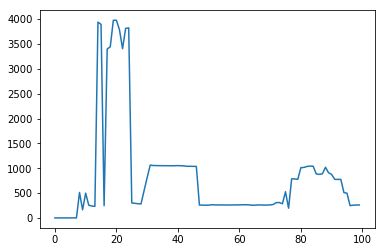

In [18]:
detect_pitch(y,sr,500)
pitch_graph = np.empty(pitches.shape[1])

for i in range(pitches.shape[1]):
    pitch_graph[i] = detect_pitch(y,sr,i)
    

data = pitch_graph

plt.plot(data[:100]) # plotting by columns
plt.show()


In [19]:
IPython.display.Audio(data=librosa.effects.pitch_shift(y, sr, n_steps=5), rate=sr)

In [27]:
def f2midi(frequency):
    return 69 + (12 * ((math.log(frequency/440)) / (math.log(2))))

def midi2note(midi_num):
    notes = ['C','C#','D','D#','E','F','F#','G','G#','A','A#','B']
    octave = int(math.floor(midi_num/12))
    index = int(midi_num % 12)
    final = notes[index] + str(octave)
    return final
    
def stepDistance(f1,f2):
    return f2midi(f1) - f2midi(2)

In [31]:
audio = y
index = int(math.ceil(len(audio)/512))
splitAudio = np.empty([index,512])

for i in range(index):
    for j in range(512):
        splitAudio[i][j] = audio[(i*512) + j]
        
#data is pitches

for i in range(index):
    splitAudio[i] = librosa.effects.pitch_shift(y=splitAudio[i],sr,n_steps=stepDistance(f1,data[i]))


        

        





[  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
  -1.52587891e-05  -1.52587891e-05   0.00000000e+00   0.00000000e+00
   0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
   0.00000000e+00   0.00000000e+00  -1.52587891e-05   0.00000000e+00
   0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
   0.00000000e+00  -1.52587891e-05   0.00000000e+00   0.00000000e+00
   0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
   0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
   0.00000000e+00   0.00000000e+00   0.00000000e+00  -1.52587891e-05
   0.00000000e+00   0.00000000e+00  -1.52587891e-05  -1.52587891e-05
   0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
   0.00000000e+00  -1.52587891e-05  -3.05175781e-05  -3.05175781e-05
  -3.05175781e-05  -1.52587891e-05   0.00000000e+00   0.00000000e+00
   0.00000000e+00  -1.52587891e-05  -3.05175781e-05  -1.52587891e-05
  -1.52587891e-05  -3.05175781e-05